# Analysis 

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.signal import find_peaks
from matplotlib.colors import LinearSegmentedColormap
import scipy.signal as ss
import matplotlib.animation as animation
from IPython.display import HTML

## Initial condition: dx = 0.1 dt = 0.05

In [2]:
dt = 0.05
dx = 0.1
h = 1.3*dx
data = pd.HDFStore('t01.h5', mode ='r')
keylist=sorted(data.keys())
tmax = len(keylist)*dt

Text(0.5, 1.0, 'y position of the max free surface height without splash filter')

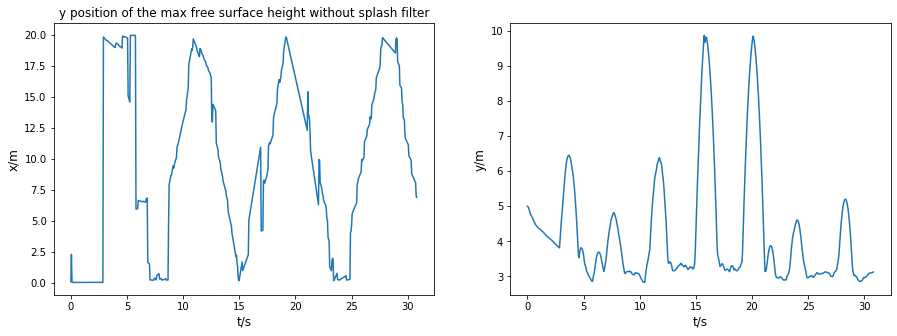

In [3]:
#without the spacing density filter
max_y = []
max_x =  []
t_list = []
for l in keylist:
    df = data.get(l)
    index = df.y.loc[df.types==0].idxmax()
    #print(df.y.iloc[index])
    max_y.append(df.y.iloc[index])
    max_x.append(df.x.iloc[index])
max_x = np.array(max_x)
max_y = np.array(max_y)

t = np.arange(0, tmax, dt)
fig, axs = plt.subplots(1, 2, figsize=(15,5))
axs[0].plot(t, max_x)
axs[0].set_ylabel('x/m', fontsize=12)
axs[0].set_xlabel('t/s', fontsize=12)
axs[1].plot(t, max_y)
axs[1].set_ylabel('y/m', fontsize=12)
axs[1].set_xlabel('t/s', fontsize=12)
axs[0].set_title('x position of the max free surface height without splash filter')
axs[0].set_title('y position of the max free surface height without splash filter')

In [4]:
k1 = keylist[0]
df = data.get(k1)
liq = df.loc[df.types==0]
maxid = liq.y.idxmax() #find the top left liquid particle
max_x =liq.x.loc[maxid]
max_y =liq.y.loc[maxid]
print('Reference point:',max_x, max_y)
#set this as a threthold to distinguish between splash or surface
n_min = round(len(liq.loc[(liq.y>max_y-2*h) & (liq.y<max_y)])/10)
print('Minimum neighbour wanted:',n_min)

Reference point: 0.1 5.0
Minimum neighbour wanted: 6


The refrence point is the point have the maximum y value at the starting time with minium x. The above commands are calculating the number of neighbour of this point and use 10% of its number of neighbour as a reference thershold.

In [5]:
#without the spacing density filter
y_peak = []
x_peak =  []
t_list = []
for l in keylist:
    df = data.get(l)
    liq = df.loc[df.types==0]
    n = 0
    i = 0
    while (i<100 and n<n_min):
        maxid = liq.y.idxmax()
        max_x = liq.x.loc[maxid]
        max_y = liq.y.loc[maxid]
        #print(max_x, max_y)
        n = len(liq.loc[(liq.y>max_y-2*h) & (liq.y<max_y+2*h) & (liq.x>max_x-2*h) & (liq.x<max_x+2*h)])
        liq = liq.loc[liq.y<max_y]
        #print(n)
        mx = [max_x, max_y]
        i = i+1
    if i==100:
        print("hitting max itr")
    y_peak.append(max_y)
    x_peak.append(max_x)

y_peak=np.array(y_peak)
x_peak=np.array(x_peak)

In [6]:
fig = plt.figure(figsize=(12, 6))
ax = fig.add_subplot(111)

plt.close()
init = data.get(keylist[0])
init_boundary = init.loc[init.types==1]
ax.plot(init_boundary.x, init_boundary.y,'.', markersize=2, color='grey')
xy, = ax.plot([],[],'.', markersize=2, color='green')
sqr, = ax.plot([],[],'k-')
maxpt, = ax.plot([],[],'.', markersize=2, color='red')
time_text = ax.text(0.78, 0.8, '', transform=ax.transAxes)

t_list = t
def init():
    xy.set_data([], [])
    sqr.set_data([], [])
    maxpt.set_data([], [])
    time_text.set_text('')
    return xy, time_text, sqr


def animate(i):
    update = data.get(keylist[i])
    square = [[x_peak[i]-2*h, x_peak[i]+2*h, x_peak[i]+2*h, x_peak[i]-2*h, x_peak[i]-2*h],
              [y_peak[i]-2*h, y_peak[i]-2*h, y_peak[i]+2*h, y_peak[i]+2*h, y_peak[i]-2*h]]
    sqr.set_data(square[0], square[1])
    liquid = update.loc[update.types==0]
    xy.set_data(liquid.x, liquid.y)
    maxpt.set_data(x_peak[i], y_peak[i])
    time_text.set_text('time = {0:.3f}'.format(t_list[i]))
    return xy, time_text, maxpt, sqr

frames = np.arange(0, len(keylist), 1)
anim = animation.FuncAnimation(fig, animate, frames,
                             blit=True, init_func=init)

    
HTML(anim.to_jshtml())

Animation size has reached 20985646 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Text(0.5, 1.0, 'y position of the max free surface height with splash filter')

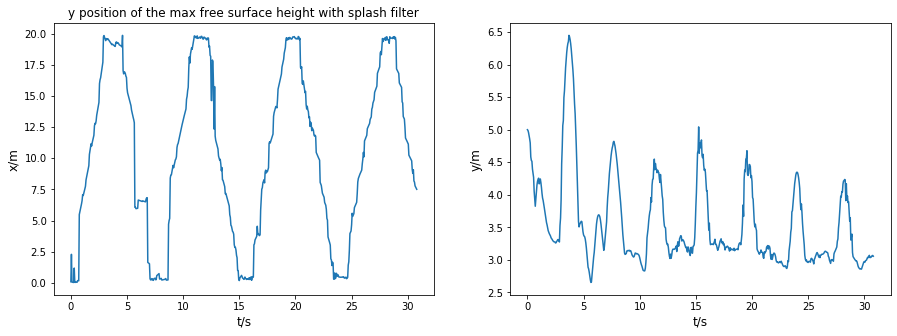

In [7]:
t = np.arange(0, tmax, dt)
fig, axs = plt.subplots(1, 2, figsize=(15,5))
axs[0].plot(t, x_peak)
axs[1].plot(t, y_peak)

axs[0].set_ylabel('x/m', fontsize=12)
axs[0].set_xlabel('t/s', fontsize=12)
axs[1].set_ylabel('y/m', fontsize=12)
axs[1].set_xlabel('t/s', fontsize=12)
axs[0].set_title('x position of the max free surface height with splash filter')
axs[0].set_title('y position of the max free surface height with splash filter')

In [8]:
a = np.where(x_peak>18)[0] # x greater than 18
peak_index = []
peak_chunk = []
peak_start = []
peak_end = []

for i in range(np.size(a)-1):
    if a[i] + 1 == a[i+1] and i+2!=np.size(a):
        peak_index.append(a[i+1])
    elif len(peak_index)>=4:
        peak_chunk.append(peak_index)
        peak_start.append(peak_index[0])
        peak_end.append(peak_index[-1])
        peak_index = []
    else: 
        peak_index = [] #clear the list if its too short

b = np.where(x_peak<2)[0] # x greater than 19
trough_index = []
trough_chunk = []
trough_start = []
trough_end = []
for i in range(np.size(b)-1):
    if b[i] + 1 == b[i+1] and i+2!=np.size(b):
        trough_index.append(b[i])
    elif len(trough_index)>=4:
        trough_chunk.append(trough_index)
        trough_start.append(trough_index[0])
        trough_end.append(trough_index[-1])
        trough_index = []
    else:
        trough_indx = []

In [9]:
data_chunk_FWD = []
t_chunk_FWD = []

for i in range(len(trough_end)):
    #print(trough_end[i],peak_start[i])
    chunk = x_peak[trough_end[i]:peak_start[i]]
    data_chunk_FWD.append(chunk)
    chunk = t[trough_end[i]:peak_start[i]]
    t_chunk_FWD.append(chunk)

data_chunk_BWD = []
t_chunk_BWD = []
for i in range(len(peak_end)):
    if i < len(trough_end)-1:
        print(peak_end[i],trough_start[i+1])
        chunk = x_peak[peak_end[i]:trough_start[i+1]]
        #print(chunk)
        data_chunk_BWD.append(chunk)
        chunk = t[peak_end[i]:trough_start[i+1]]
        #print(chunk)
        t_chunk_BWD.append(chunk)

92 137
249 297
408 463


In [10]:
peak_middle= []
trough_middle = []

data_chunk_FWD = []
t_chunk_FWD = []

for i in range(len(trough_end)):
    print(trough_end[i],peak_start[i])
    chunk = x_peak[trough_end[i]:peak_start[i]]
    data_chunk_FWD.append(chunk)
    chunk = t[trough_end[i]:peak_start[i]]
    t_chunk_FWD.append(chunk)

data_chunk_BWD = []
t_chunk_BWD = []
for i in range(len(peak_end)):
    if i < len(trough_end)-1:
        print(peak_end[i],trough_start[i+1])
        chunk = x_peak[peak_end[i]:trough_start[i+1]]
        #print(chunk)
        data_chunk_BWD.append(chunk)
        chunk = t[peak_end[i]:trough_start[i+1]]
        #print(chunk)
        t_chunk_BWD.append(chunk)

13 59
172 214
324 381
493 552
92 137
249 297
408 463


Text(0.5, 0, 'no of period')

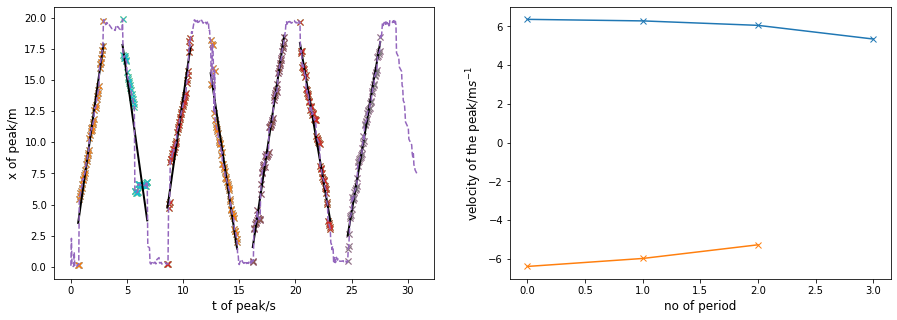

In [11]:
fig, axs = plt.subplots(1, 2, figsize=(15,5))
FWD_vel = []
for i in range(len(t_chunk_FWD)):
    axs[0].plot(t_chunk_FWD[i], data_chunk_FWD[i],'x')
    axs[0].plot(t_chunk_FWD[i], data_chunk_FWD[i],'x')
    line_fit = np.polyfit(t_chunk_FWD[i], data_chunk_FWD[i], 1)
    axs[0].plot(t_chunk_FWD[i], line_fit[0] * t_chunk_FWD[i] + line_fit[1],
            'k-', label = 'slope: {:.4f}'.format(line_fit[0]), linewidth=2)
    FWD_vel.append(line_fit[0])

BWD_vel = []
for i in range(len(t_chunk_BWD)):
    axs[0].plot(t_chunk_BWD[i], data_chunk_BWD[i],'x')
    axs[0].plot(t_chunk_BWD[i], data_chunk_BWD[i],'x')
    line_fit = np.polyfit(t_chunk_BWD[i], data_chunk_BWD[i], 1)
    axs[0].plot(t_chunk_BWD[i], line_fit[0] * t_chunk_BWD[i] + line_fit[1],
            'k-', label = 'slope: {:.4f}'.format(line_fit[0]), linewidth=2)
    BWD_vel.append(line_fit[0])

axs[0].plot(t, x_peak, '--')
axs[0].set_ylabel('x of peak/m', fontsize=12)
axs[0].set_xlabel('t of peak/s', fontsize=12)
axs[1].plot(FWD_vel,'x-')
axs[1].plot(BWD_vel,'x-')
axs[1].set_ylabel('velocity of the peak/m$s^{-1}$', fontsize=12)
axs[1].set_xlabel('no of period', fontsize=12)

In [12]:
print('Forward Sloashing velocity in m/s:', FWD_vel)
print('Average Forward Sloasing velocity in m/s:', sum(FWD_vel)/len(FWD_vel))
print('Forward Sloashing velocity in m/s:', BWD_vel)
print('Average Forward Sloasing velocity in m/s:', sum(BWD_vel)/len(BWD_vel))
print('Average Sloasing speed in m/s:', (sum(FWD_vel)/len(FWD_vel)-sum(BWD_vel)/len(BWD_vel))/2)

Forward Sloashing velocity in m/s: [6.36420896947271, 6.284385168138723, 6.054301388384751, 5.348308237288136]
Average Forward Sloasing velocity in m/s: 6.01280094082108
Forward Sloashing velocity in m/s: [-6.394629009222658, -5.982364341076851, -5.2767314271284285]
Average Forward Sloasing velocity in m/s: -5.884574925809313
Average Sloasing speed in m/s: 5.948687933315197


In [13]:
print('Expected shallow water wave speed:', (9.8*(5*3+2*17)/20)**0.5)

Expected shallow water wave speed: 4.9


The expected shallow water wave speed of $\sqrt{gh_0} = 4.9$ if the average intial water depth is calculated accroding to the initial free surface line. However, the average sloashing speed we have is greater than this value. It may be caused by the repulsive force added near the boundary layer. Also, artifical visicosity was not added in the code. The particles would be coupled together once they get too close to each other which would cause a higher pressure and density than the real value. The can might affact the value of our sloashing velocity.

However, we will not get a value of 4.9 in our simulation. The expected shallow water water speed eventually become smaller. 

In [14]:
keylist[0]
init = data.get(keylist[0])
init_liq = init.loc[init.types==0]
inimaxy = np.array(df.groupby(['x'], sort=False)['y'].max())
ave = np.mean(inimaxy)
print('Expected shallow water wave speed calculated according to the average initial liquid particle height:', (9.8*ave)**0.5)

Expected shallow water wave speed calculated according to the average initial liquid particle height: 3.6822859470325935


## Sloshing velocity without boundary repulsive force

This image shows the sloshing velocity when the bounary repulsive force was not added. Instead, the particle will get an inverse velocity. The sloshing velocity becomes above $10 ms^{-1}$. By adding a repulsive force at the boundary already significantly bring the result closer to the expected result. 
![Without Replusive Force](withoutReplusiveForce.png)